In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import numpy as np
import pandas as pd
from pathlib import Path
import openslide
import matplotlib.pyplot as plt
import cv2
import json
from enum import Enum
from probreg import transformation as tf
from PIL import Image
import copy
import matplotlib.patches as patches

from sklearn import linear_model
from sklearn.ensemble import IsolationForest
from sklearn import svm
from probreg.filterreg import registration_filterreg
from sklearn.neighbors import LocalOutlierFactor

In [4]:
from probreg import cpd
from probreg import callbacks
import open3d as o3

In [5]:
import sys
sys.path.append("..")
from registration_tree import Rect, QuadTree

## Background
- https://www.learnopencv.com/homography-examples-using-opencv-python-c/
- http://www.cs.columbia.edu/~allen/F17/NOTES/homography_pka.pdf
- https://siavashk.github.io/2017/05/14/coherent-point-drift/

In [16]:
slide_paths = list(Path(r"D:\Datasets\ScannerStudy").glob("*/*/*.*"))

if len(slide_paths) == 0:
    slide_paths = list(Path(r"/data/ScannerStudy").glob("*\*\*.*"))


print(len(slide_paths))

slide_paths = {path.name: path for path in slide_paths}

76


In [31]:
patient_id = "563476"
image_type = "BB_"

patient_id = "29609B"
image_type = "CCMCT_"

file_scanner = {
    f"A_{image_type}{patient_id}_1.svs": {"Name": "Aperio", "slide": None, "thumbnail": None},
    f"Z_{image_type}{patient_id}_1.tif": {"Name":"AxioScan", "slide": None, "thumbnail": None},
    f"N2_{image_type}{patient_id}_1.ndpi": {"Name": "NanoZoomer2.0HT", "slide": None, "thumbnail": None},
    f"N1_{image_type}{patient_id}_1.ndpi": {"Name": "NanoZoomerS210", "slide": None, "thumbnail": None},
}

In [32]:
df = pd.read_csv("CCMCT/CCMCT.csv", delimiter=";", names=["image_name", "grade", "vector"])
df["vector"] = [json.loads(vector)  for vector in df["vector"]]

df["x1"] = [vector['x1'] if type(vector) is dict else 0 for vector in df["vector"]]
df["y1"] = [vector['y1'] if type(vector) is dict else 0 for vector in df["vector"]]

df["x2"] = [vector['x2'] if type(vector) is dict else 0 for vector in df["vector"]]
df["y2"] = [vector['y2'] if type(vector) is dict else 0 for vector in df["vector"]]

df["center_x"] = [x1 + ((x2-x1) / 2) for x1, x2 in zip(df["x1"], df["x2"])]
df["center_y"] = [y1 + ((y2-y1) / 2) for y1, y2 in zip(df["y1"], df["y2"])]

df["anno_width"] = [x2-x1 for x1, x2 in zip(df["x1"], df["x2"])]
df["anno_height"]= [y2-y1 for y1, y2 in zip(df["y1"], df["y2"])]

df.head()

,image_name,grade,vector,x1,y1,x2,y2,center_x,center_y,anno_width,anno_height
0,A_CCMCT_29609B_1.svs,mitosis,"{'x1': 57204, 'y1': 28229, 'x2': 57254, 'y2': ...",57204,28229,57254,28279,57229.0,28254.0,50,50
1,A_CCMCT_29609B_1.svs,mitosis,"{'x1': 57895, 'y1': 37440, 'x2': 57945, 'y2': ...",57895,37440,57945,37490,57920.0,37465.0,50,50
2,A_CCMCT_29609B_1.svs,mitosis,"{'x1': 54810, 'y1': 37131, 'x2': 54860, 'y2': ...",54810,37131,54860,37181,54835.0,37156.0,50,50
3,A_CCMCT_29609B_1.svs,mitosis,"{'x1': 54575, 'y1': 34537, 'x2': 54625, 'y2': ...",54575,34537,54625,34587,54600.0,34562.0,50,50
4,A_CCMCT_29609B_1.svs,mitosis,"{'x1': 47883, 'y1': 28677, 'x2': 47933, 'y2': ...",47883,28677,47933,28727,47908.0,28702.0,50,50


In [33]:
def get_region_thumbnail(slide, boundary:Rect, size=(2048, 2048), depth=1):

    scale = []

    downsample = max(*[dim / thumb for dim, thumb in zip((boundary.w, boundary.h), (size[0] * depth, size[1] * depth))])        
    level = slide.get_best_level_for_downsample(downsample)

    downsample = slide.level_downsamples[level]

    x, y, w, h = int(boundary.west_edge), int(boundary.north_edge), int(boundary.w / downsample), int(boundary.h / downsample)
    scale.append(np.array((boundary.w, boundary.h)) / (w, h))

    tile = slide.read_region((x, y), level, (w, h))

    thumb = Image.new('RGB', tile.size, '#ffffff')
    thumb.paste(tile, None, tile)
    thumb.thumbnail(size, Image.ANTIALIAS)
    scale.append(np.array([w, h]) / thumb.size)

    return thumb, scale

Wall time: 18.7 s


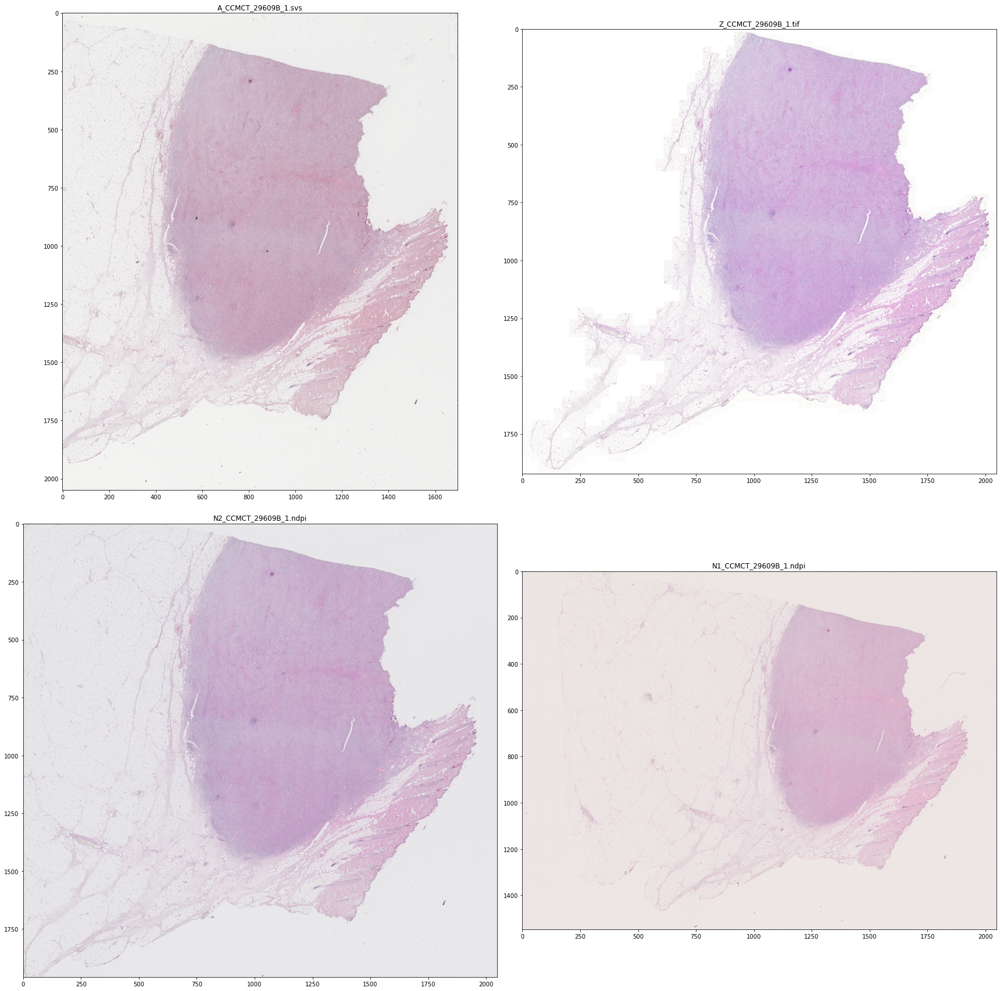

In [34]:
%%time

f, axarr = plt.subplots(2,2,figsize=(24,24))

for id, path in enumerate(file_scanner.keys()):
    
    slide = openslide.OpenSlide(filename=str(slide_paths[path]))
    file_scanner[path]["slide"] = slide
    
    dimension = Rect.create(Rect, 0, 0, slide.dimensions[0], slide.dimensions[1])
    thumbnail, scale = get_region_thumbnail(slide, dimension, size=(2048, 2048))
    
    file_scanner[path]["scale"] = scale

    file_scanner[path]["thumbnail"] = thumbnail
        
    if id == 0: axarr[0,0].imshow(thumbnail); axarr[0,0].set_title(path)
    if id == 1: axarr[0,1].imshow(thumbnail); axarr[0,1].set_title(path)
    if id == 2: axarr[1,0].imshow(thumbnail); axarr[1,0].set_title(path)
    if id == 3: axarr[1,1].imshow(thumbnail); axarr[1,1].set_title(path)    
        
plt.tight_layout()

plt.savefig(f'{path.split("_")[2]}.pdf')  

In [25]:
path.split("_")[2]

'563476'

In [38]:
def extract_matching_points(source_image, target_image, maxFeatures:int=500, 
                    keepPercent:float=0.2, debug=False, 
                    source_scale:[tuple]=[(1,1)], target_scale:[tuple]=[(1,1)]):

    source_scale = np.array(source_scale)
    target_scale = np.array(target_scale)

    source_image = np.array(source_image) if type(source_image) == Image.Image else source_image
    target_image = np.array(target_image) if type(target_image) == Image.Image else target_image
        
    # convert both the input image and template to grayscale
    imageGray = cv2.cvtColor(source_image, cv2.COLOR_BGR2GRAY) 
    templateGray = cv2.cvtColor(target_image, cv2.COLOR_BGR2GRAY)
        

    kpsA, kpsB, matches = [], [], []
    # extract features from the four regions top right, top left ...
    for region in       [
                             NodeOrientation.TOP,
                             #NodeOrientation.NORTH_WEST, 
                             #NodeOrientation.NORTH_EAST,
                             #NodeOrientation.SOUTH_WEST, 
                             #NodeOrientation.SOUTH_EAST
                            ]:

        # set all non active regions to zero
        region_image = np.zeros_like(imageGray)
        region_template = np.zeros_like(templateGray)

        y_center_region, x_center_region =      np.array(region_image.shape[:2]) // 2
        y_center_template, x_center_template =  np.array(region_template.shape[:2]) // 2

        if region == NodeOrientation.TOP:
            region_image = imageGray
            region_template = templateGray

        if region == NodeOrientation.NORTH_WEST:
            region_image[:y_center_region, :x_center_region] = imageGray[:y_center_region, :x_center_region]
            region_template[:y_center_template, :x_center_template] = templateGray[:y_center_template, :x_center_template]

        if region == NodeOrientation.NORTH_EAST:
            region_image[:y_center_region, x_center_region:] = imageGray[:y_center_region, x_center_region:]
            region_template[:y_center_template, x_center_template:] = templateGray[:y_center_template, x_center_template:]

        if region == NodeOrientation.SOUTH_WEST:
            region_image[y_center_region:, :x_center_region] = imageGray[y_center_region:, :x_center_region]
            region_template[y_center_template:, :x_center_template] = templateGray[y_center_template:, :x_center_template]

        if region == NodeOrientation.SOUTH_EAST:
            region_image[y_center_region:, x_center_region:] = imageGray[y_center_region:, x_center_region:]
            region_template[y_center_template:, x_center_template:] = templateGray[y_center_template:, x_center_template:]

        # use ORB to detect keypoints and extract (binary) local
        # invariant features
        orb = cv2.ORB_create(maxFeatures)
        (kpsA_region, descsA) = orb.detectAndCompute(region_image, None)
        (kpsB_region, descsB) = orb.detectAndCompute(region_template, None)
        # match the features
        method = cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING
        matcher = cv2.DescriptorMatcher_create(method)
        matches_region = matcher.match(descsA, descsB, None)

        # add image patch offset for each match
        for match in matches_region:
            match.trainIdx += len(kpsA)
            match.queryIdx += len(kpsB)
                        
        # sort the matches by their distance (the smaller the distance,
        # the "more similar" the features are)
        matches_region = sorted(matches_region, key=lambda x:x.distance)

        # keep only the top matches
        #keep = int(len(matches_region) * keepPercent)
        #matches_region = matches_region[:4]

        kpsA.extend(kpsA_region)
        kpsB.extend(kpsB_region)
        matches.extend(matches_region)


    # divide image into x sub patch and find best match for each sub patch
    y_step, x_step = np.array(region_image.shape[:2]) // 8
    source_points = np.array([p.pt for p in kpsA])
    filtered_matches = []
    for x in range(0, region_image.shape[1], x_step):
        for y in range(0, region_image.shape[0], y_step):

            idxs = np.nonzero((source_points[:, 0] > y) & (source_points[:, 0] < y + y_step) & 
                                        (source_points[:, 1] > x) & (source_points[:, 1] < x + x_step))[0]

            #cv2.rectangle(source_image, (x,y), (x+x_step, y+y_step), (255,0,0), 3) 
            #cv2.rectangle(target_image, (x,y), (x+x_step, y+y_step), (255,0,0), 3) 

            if len(idxs) > 0:
                for match in matches:
                    if match.queryIdx in idxs:
                        filtered_matches.append(match)
                        break
    matches = filtered_matches


    # check to see if we should visualize the matched keypoints
    matchedVis = None
    if debug:
        matchedVis = cv2.drawMatches(source_image, kpsA, target_image, kpsB, matches, None)
            
    # allocate memory for the keypoints (x, y)-coordinates from the
    # top matches -- we'll use these coordinates to compute our
    # homography matrix
    ptsA = np.zeros((len(matches), 2), dtype="float")
    ptsB = np.zeros((len(matches), 2), dtype="float")
    # loop over the top matches
    for (i, m) in enumerate(matches):
        # indicate that the two keypoints in the respective images
        # map to each other
        ptsA[i] = kpsA[m.queryIdx].pt
        ptsB[i] = kpsB[m.trainIdx].pt

        # scale points 
        for s_scale, t_scale in zip(source_scale, target_scale):
            ptsA[i] *= s_scale 
            ptsB[i] *= t_scale 

    return ptsA, ptsB, matchedVis

In [39]:
%%time

source_file = "24_EIPH_576255 Berliner Blau.svs"
source_image = np.array(file_scanner[source_file]["thumbnail"])
source_scale = file_scanner[source_file]["scale"]

for path in df["image_name"].unique():
    print(path)
    
    if path != "N2_BB_576255_1.ndpi":
        continue
    
    target_image = np.array(file_scanner[path]["thumbnail"])
    target_scale = file_scanner[path]["scale"]
    
    ptsA, ptsB, matchedVis = align_images(source_image, target_image, debug=True, 
                                          source_scale=source_scale, target_scale=target_scale)
    
    scales =  ptsA / ptsB 
    inliners = LocalOutlierFactor(n_neighbors=20).fit_predict(scales) == 1
    
    tf_param, sigma2, q = cpd.registration_cpd(ptsA[inliners], ptsB[inliners], 'affine')
    
    file_scanner[path]["sigma2"] = sigma2
    file_scanner[path]["q"] = q
    file_scanner[path]["ptsA"] = ptsA
    file_scanner[path]["ptsB"] = ptsB
    file_scanner[path]["mpp_x_scale"] = tf_param.b[0][0]
    file_scanner[path]["mpp_y_scale"] = tf_param.b[1][1]
    file_scanner[path]["tf_b"] = tf_param.b
    file_scanner[path]["tf_t"] = tf_param.t
    
    plt.imshow(matchedVis)
    plt.show()

A_CCMCT_29609B_1.svs
A_CCMCT_22108_1.svs
A_CCMCT_518711B_1.svs
A_CCMCT_183715A_1.svs
A_CCMCT_380609B_1.svs
Wall time: 19 ms


In [34]:
source_file = "24_EIPH_576255 Berliner Blau.svs"
source_slide = file_scanner[source_file]["slide"]

tf_b = file_scanner[source_file]["tf_b"]    
tf_t = file_scanner[source_file]["tf_t"]    
source_af = tf.AffineTransformation(tf_b, tf_t)

x_source, y_source = 768, 768

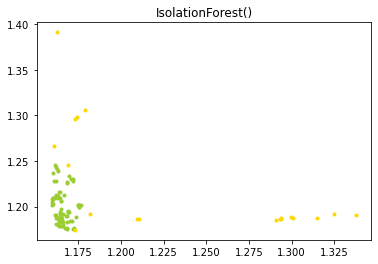

Z_BB_576255_1.tif
81 107.8000209066603


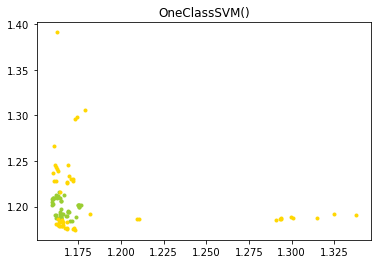

Z_BB_576255_1.tif
49 85.54003285631842


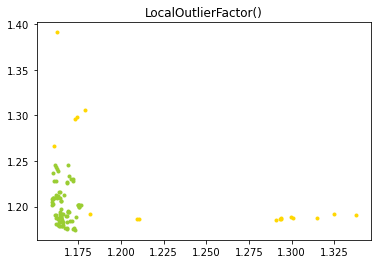

Z_BB_576255_1.tif
83 103.91271966911224


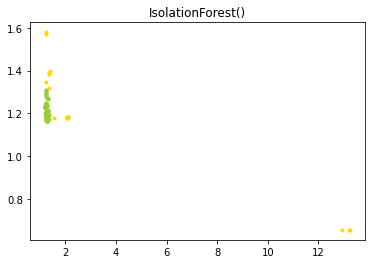

N2_BB_576255_1.ndpi
80 122.99377695322036


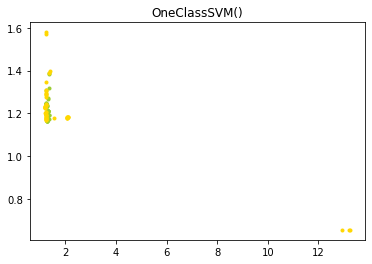

N2_BB_576255_1.ndpi
50 125.05861224174498


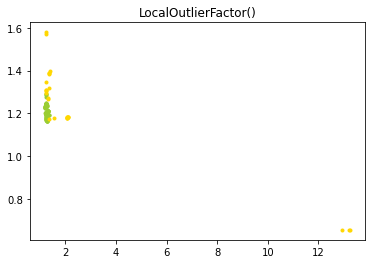

N2_BB_576255_1.ndpi
73 105.53243689341087


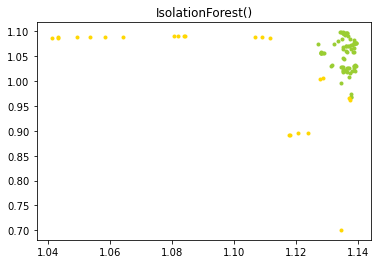

N1_BB_576255_1.ndpi
77 122.915918944718


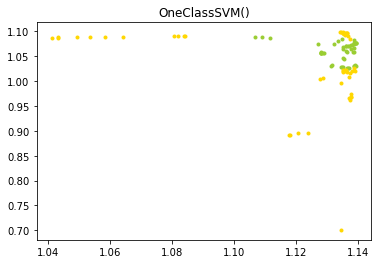

N1_BB_576255_1.ndpi
49 137.8501631970308


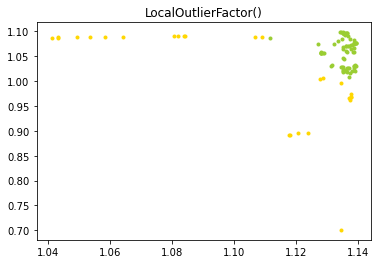

N1_BB_576255_1.ndpi
74 123.79611509555093


In [35]:
for id, path in enumerate(df["file"].unique()):

    ptsB = file_scanner[path]["ptsA"]    
    ptsA = file_scanner[path]["ptsB"]   
    
    temp_ptsA, temp_ptsB = ptsA.copy(), ptsB.copy()

    scales =  temp_ptsA / temp_ptsB
    x,y = scales[:, 0], scales[:, 1]
    
    #print(scales.mean())
    
    # perfekt allignment not need to optimise
    if scales.mean() > 0.95 and scales.mean() < 1.05:
        continue

    for cls in [IsolationForest(), svm.OneClassSVM(kernel="rbf"), LocalOutlierFactor(n_neighbors=20)]:
        
        outliners = cls.fit_predict(scales)

        inlier_mask = outliners == 1
        outlier_mask = outliners == -1

        plt.scatter(x[inlier_mask], y[inlier_mask], color='yellowgreen', marker='.', label='Inliers')
        plt.scatter(x[outlier_mask], y[outlier_mask], color='gold', marker='.', label='Outliers')
        plt.title(str(cls))
        plt.show()

        tf_param, sigma2, q = cpd.registration_cpd(ptsA[inlier_mask], ptsB[inlier_mask], 'affine')
        
        print(f"{path}")
        print(f"{np.count_nonzero(inlier_mask)} {sigma2}") 

## CPD

### Calc mpp scale

In [36]:
mpp_x_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_X, np.NaN))
mpp_y_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, np.NaN))

for id, path in enumerate(df["file"].unique()):
    
    slide = file_scanner[path]["slide"]
    mpp_x_target = float(slide.properties.get(openslide.PROPERTY_NAME_MPP_X, 0.221))
    mpp_y_target = float(slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, 0.221))
    
    mpp_x_scale, mpp_y_scale = None, None
    if np.isnan(mpp_x_target) == False and np.isnan(mpp_y_target) == False:
        mpp_x_scale_scanner = mpp_x_source / mpp_x_target
        mpp_y_scale_scanner = mpp_y_source / mpp_y_target
    
    mpp_x_scale = file_scanner[path]["mpp_x_scale"]
    mpp_y_scale = file_scanner[path]["mpp_y_scale"]
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_param = tf.AffineTransformation(tf_b, tf_t)
    
    sigma2, q = file_scanner[path]["sigma2"], file_scanner[path]["q"]
    
    print(f'{path}: X: {mpp_x_target:4.3f} Y: {mpp_y_target:4.3f}')
    print(f'XS: {mpp_x_scale_scanner:4.3f} YS: {mpp_y_scale_scanner:4.3f}')
    print(f'CS: {mpp_x_scale:4.3f} CS: {mpp_y_scale:4.3f}')
    print(f'x: [{tf_param.b[0][0]:4.3f}, {tf_param.b[0][1]:4.3f}, {tf_param.t[0]:4.3f}], y: [{tf_param.b[1][0]:4.3f}, {tf_param.b[1][1]:4.3f}, {tf_param.t[1]:4.3f}]]')
    print(f"sigma2: {sigma2:4.3f}   q: {q:4.3f}")
    print("")

24_EIPH_576255 Berliner Blau.svs: X: 0.253 Y: 0.253
XS: 1.000 YS: 1.000
CS: 1.000 CS: 1.000
x: [1.000, -0.000, 0.000], y: [0.000, 1.000, 0.000]]
sigma2: 0.000   q: -1590.238

Z_BB_576255_1.tif: X: 0.221 Y: 0.221
XS: 1.146 YS: 1.146
CS: 1.149 CS: 1.148
x: [1.149, 0.009, 246.517], y: [-0.008, 1.148, 898.499]]
sigma2: 129.428   q: 486.639

N2_BB_576255_1.ndpi: X: 0.226 Y: 0.228
XS: 1.119 YS: 1.113
CS: 1.119 CS: 1.113
x: [1.119, 0.006, 2701.824], y: [-0.006, 1.113, 1557.266]]
sigma2: 151.217   q: 457.422

N1_BB_576255_1.ndpi: X: 0.221 Y: 0.221
XS: 1.148 YS: 1.148
CS: 1.148 CS: 1.147
x: [1.148, 0.001, -289.709], y: [-0.002, 1.147, -1334.194]]
sigma2: 161.310   q: 450.166



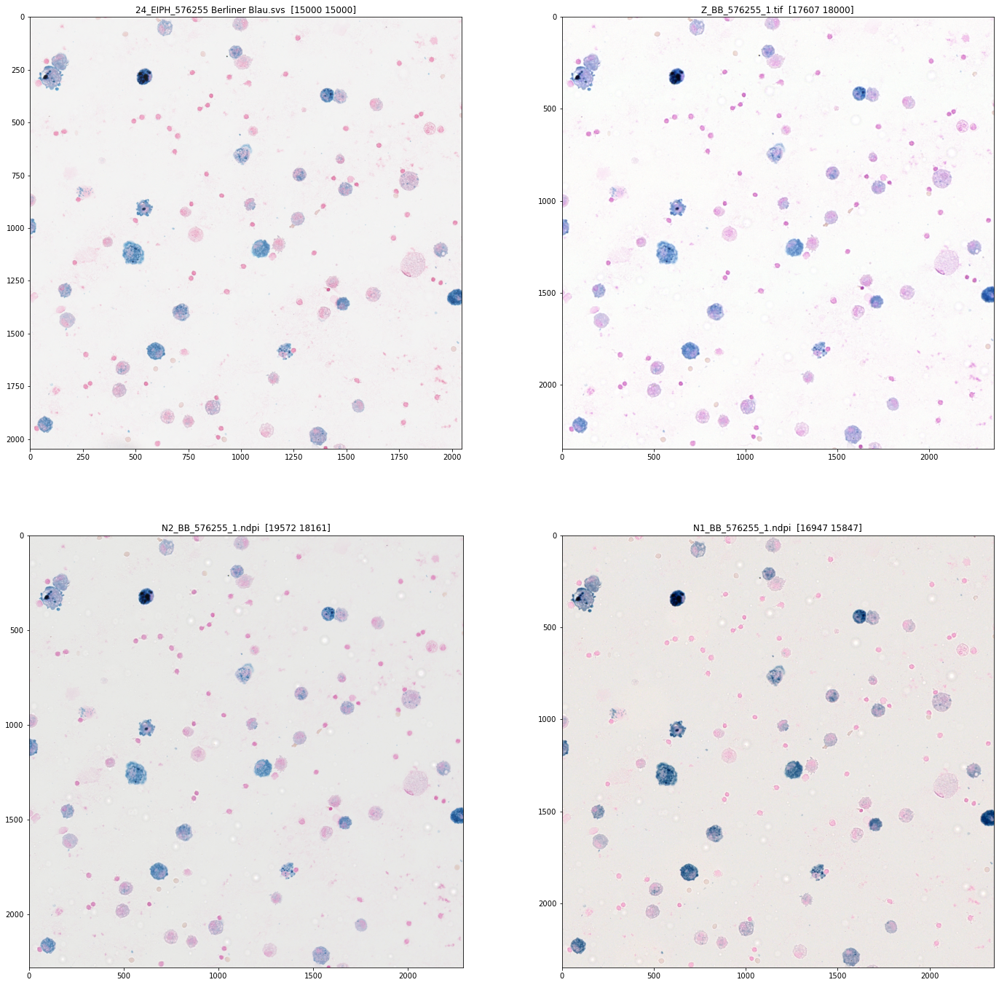

In [37]:
f, axarr = plt.subplots(2,2,figsize=(24,24))

for id, path in enumerate(df["file"].unique()):
    patch_width, patch_height = 2048, 2048
    target_slide = file_scanner[path]["slide"]
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
    
    patch_width, patch_height = int(patch_width * file_scanner[path]["mpp_x_scale"]), int(patch_height * file_scanner[path]["mpp_y_scale"])
    transformed = tf_temp.transform(np.array([15000, 15000])).astype(int)
    
    image_target = target_slide.read_region(location=(transformed), level=0, size=(patch_width, patch_height))

    if id == 0: axarr[0,0].imshow(image_target); axarr[0,0].set_title(f'{path}  {transformed}')
    if id == 1: axarr[0,1].imshow(image_target); axarr[0,1].set_title(f'{path}  {transformed}')
    if id == 2: axarr[1,0].imshow(image_target); axarr[1,0].set_title(f'{path}  {transformed}')
    if id == 3: axarr[1,1].imshow(image_target); axarr[1,1].set_title(f'{path}  {transformed}')

## Feature Points WSI

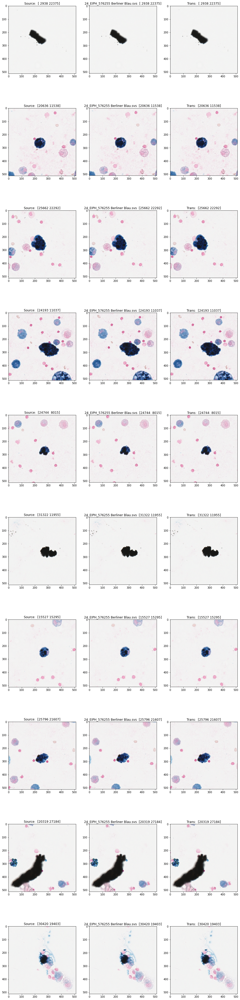

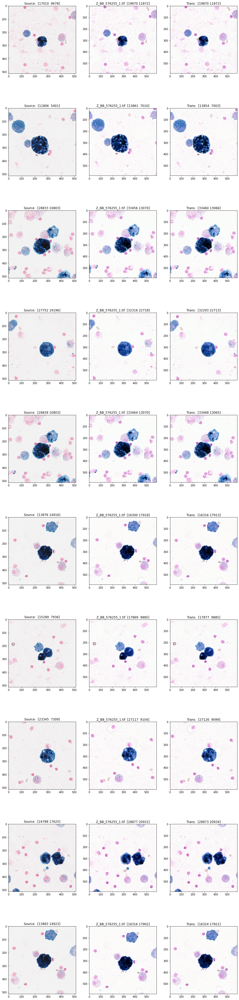

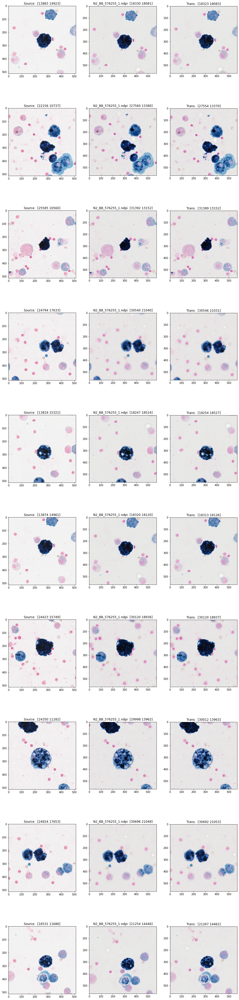

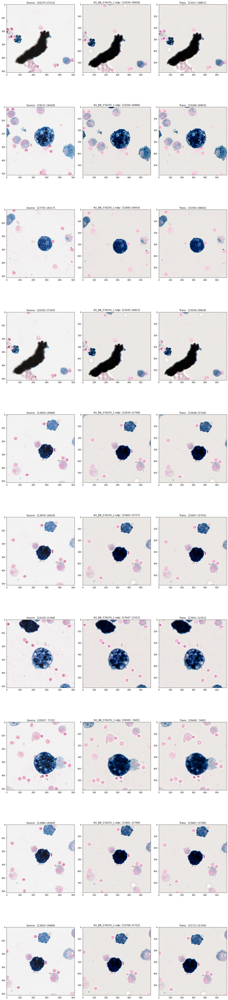

In [38]:
num_patches = 10
size = 512

for id, path in enumerate(df["file"].unique()):
    
    f, axarr = plt.subplots(num_patches, 3, figsize=(16, 72))
        
    target_slide = file_scanner[path]["slide"]    
    
    ptsA = file_scanner[path]["ptsA"].copy()
    ptsB = file_scanner[path]["ptsB"].copy()
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
       
    
    for idx, (pA, pB) in enumerate(zip(ptsA, ptsB)):
        
        transformed = tf_temp.transform(pA.copy())  
        
        pA = pA.astype(int)
        pB = pB.astype(int)
        transformed = transformed.astype(int)
        
        size_target_x, size_target_y = int(size * file_scanner[path]["mpp_x_scale"]), int(size * file_scanner[path]["mpp_y_scale"])
    
        image_source = source_slide.read_region(location=pA.astype(int) - (size // 2, size // 2), 
                                                level=0, size=(size, size))
        image_target = target_slide.read_region(location=pB.astype(int) - (size_target_x // 2, size_target_y // 2), 
                                                level=0, size=(size_target_x, size_target_y))
        image_target_trans = target_slide.read_region(location=transformed - (size_target_x // 2, size_target_y // 2), 
                                                level=0, size=(size_target_x, size_target_y))
            
    
        axarr[idx,0].set_title(f'Source:  {pA}')
        axarr[idx,1].set_title(f'{path}  {pB}')
        axarr[idx,2].set_title(f'Trans:  {transformed}')
        
        axarr[idx,0].imshow(image_source)
        axarr[idx,1].imshow(image_target)
        axarr[idx,2].imshow(image_target_trans)
        
        if num_patches-1 == idx:
            break

plt.tight_layout()    

## Annotations

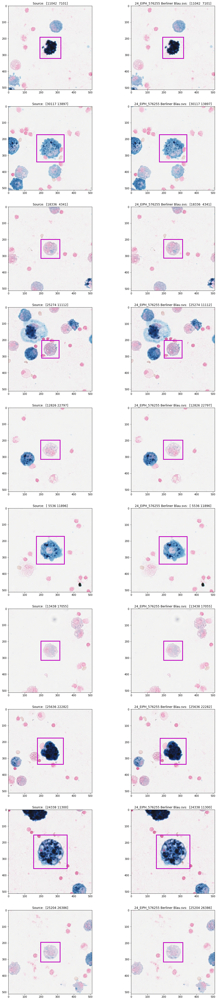

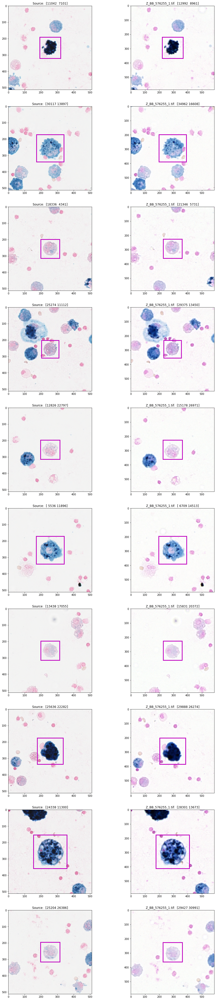

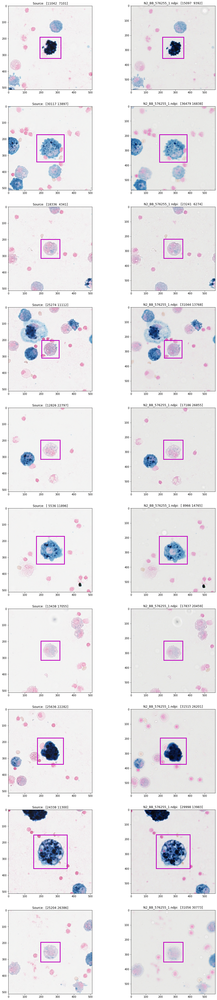

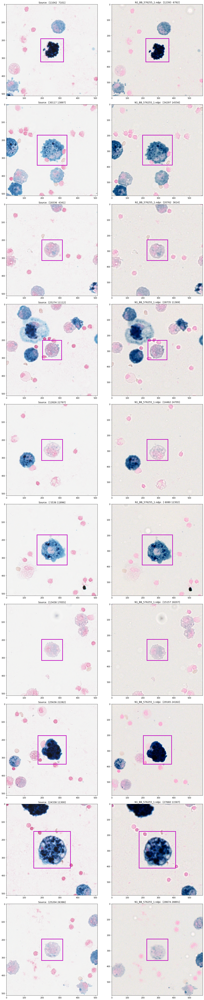

In [42]:
num_patches = 10
size = 512

df_gt = df[df["file"] == "24_EIPH_576255 Berliner Blau.svs"]

for id, path in enumerate(df["file"].unique()):
    
    f, axarr = plt.subplots(num_patches, 2, figsize=(16, 72))
        
    target_slide = file_scanner[path]["slide"]    
    
    ptsA = file_scanner[path]["ptsA"].copy()
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
       
    
    for idx, row in df_gt.iterrows():
        
        
        pA = np.array([row.center_x, row.center_y]).astype(int)
        source_anno_width, source_anno_height = row.x2 - row.x1, row.y2 - row.y1
        source_x1, source_y1 = (size / 2) - source_anno_width / 2, (size / 2)  - source_anno_height / 2
        
        transformed = tf_temp.transform(pA.copy()).astype(int)
        
        size_target_x, size_target_y = int(size * file_scanner[path]["mpp_x_scale"]), int(size * file_scanner[path]["mpp_y_scale"])
    
    
        target_anno_width, target_anno_height = int((row.x2 - row.x1) * file_scanner[path]["mpp_x_scale"]), int((row.y2 - row.y1) * file_scanner[path]["mpp_y_scale"])
            
        target_x1, target_y1 = (size_target_x / 2) - target_anno_width / 2, (size_target_y / 2)  - target_anno_height / 2
        
    
        image_source = source_slide.read_region(location=pA.astype(int) - (size // 2, size // 2), 
                                                level=0, size=(size, size))
        image_target_trans = target_slide.read_region(location=transformed - (size_target_x // 2, size_target_y // 2), 
                                                level=0, size=(size_target_x, size_target_y))
            
    
        axarr[idx,0].set_title(f'Source:  {pA}')
        axarr[idx,1].set_title(f'{path}:  {transformed}')
                
        
        axarr[idx,0].imshow(image_source)
        rect = patches.Rectangle((source_x1, source_y1), source_anno_width, source_anno_height, 
                                 linewidth=3, edgecolor='m', facecolor='none')
        axarr[idx,0].add_patch(rect)
        
        
        axarr[idx,1].imshow(image_target_trans)        
        rect = patches.Rectangle((target_x1, target_y1), target_anno_width, target_anno_height, 
                                 linewidth=3, edgecolor='m', facecolor='none')
        axarr[idx,1].add_patch(rect)
        
        if num_patches-1 == idx:
            break

plt.tight_layout()    